In [1]:
#!/usr/bin/env python2
import os
import sys
import argparse
import time
from distutils.dir_util import copy_tree


import numpy as np
import random
import theano
import theano.tensor as T
from theano import config
import lasagne
from lasagne.regularization import regularize_network_params
from lasagne.objectives import binary_crossentropy

from iterator import Iterator
import autoencoder_model as ae_model

import PIL.Image as Image
from matplotlib import pyplot as plt
from matplotlib import colors
%matplotlib inline


_FLOATX = config.floatX


Using gpu device 0: GeForce GTX 1080 (CNMeM is enabled with initial size: 95.0% of memory, cuDNN 5105)
/u/larocste/.local/lib/python2.7/site-packages/theano/sandbox/cuda/__init__.py:600: UserWarning: Your cuDNN version is more recent than the one Theano officially supports. If you see any problems, try updating Theano or downgrading cuDNN to version 5.
  warnings.warn(warn)


In [2]:
# from lasagne.layers import InputLayer, EmbeddingLayer, LSTMLayer

# essai_var = T.matrix('essai')
# net = {}
# net['in'] = InputLayer((10, 5), input_var = essai_var)
# net['emb'] = EmbeddingLayer(net['in'], input_size=2, output_size=3 )
# net['lstm'] = LSTMLayer(net['emb'], num_units = 4, only_return_final=True)

# for l in net :
#     print l, net[l].output_shape

lstm (10, 4)
emb (10, 5, 3)
in (10, 5)


In [40]:
#Training hyper-parameters

learning_rate = 0.01
weight_decay = 0
num_epochs = 500
max_patience = 100
#data_augmentation={}
SAVEPATH = 'save_models' 
LOADPATH = 'load_models'
batch_size = 512
extract_center = True
load_caption = True
#nb_discriminator_steps = 2

#Model Hyperparameters
conv_before_pool=[2,2]
n_filters = 32                      
code_size = 1
filter_size = 3
pool_factor = 2


emb_type ='gru'
emb_size = 300
cap_code_size = 300


In [41]:
#######################
# Saving path and stuff
######################
exp_name = 'AE_notebook'
exp_name += '_lr='+str(learning_rate)
exp_name += '_conv='+str(conv_before_pool)
exp_name += '_nfilt='+str(n_filters)
exp_name += '_code='+str(code_size)
exp_name += '_embtype=' + emb_type
if emb_type!= 'one_hot':
    exp_name += '_embsize='+str(emb_size)
exp_name += '_capcode='+str(cap_code_size)
exp_name += '_caps'



savepath=os.path.join(sys.path[1],SAVEPATH, exp_name)
loadpath=os.path.join(sys.path[1],LOADPATH, exp_name)

if not os.path.exists(savepath):
    os.makedirs(savepath)
else:
    print('\033[93m The following folder already exists {}. '
          'It will be overwritten in a few seconds...\033[0m'.format(
              savepath))
print 'Saving directory : ' + savepath
print 'Loading directory : '+ loadpath

Saving directory : /u/larocste/ift6266_project/save_models/AE_notebook_lr=0.01_conv=[2, 2]_nfilt=32_code=1_embtype=gru_embsize=300_capcode=300_caps
Loading directory : /u/larocste/ift6266_project/load_models/AE_notebook_lr=0.01_conv=[2, 2]_nfilt=32_code=1_embtype=gru_embsize=300_capcode=300_caps


In [42]:
def load_dataset(batch_size, extract_center, load_caption):
    

    print "Loading training data..." 
    train_iter = Iterator(which_set='train', batch_size = batch_size,
                extract_center = extract_center, load_caption = load_caption)

    print "Loading validation data..." 
    valid_iter = Iterator(which_set='valid', batch_size = batch_size,
                extract_center = extract_center, load_caption = load_caption)
    
    test_iter = None
    
    return train_iter, valid_iter, test_iter
    

In [43]:
train_iter, valid_iter, test_iter = load_dataset(batch_size=batch_size, extract_center=extract_center, load_caption=load_caption)

vocab_size = len(train_iter.vocab)
print 'Vocabulary size : ', vocab_size

n_batches_train = train_iter.n_batches
n_batches_valid = valid_iter.n_batches
n_batches_test = test_iter.n_batches if test_iter is not None else 0

print "Batch. train: %d, val %d, test %d" % (n_batches_train,
                            n_batches_valid, n_batches_test)

Loading training data...
Loading the captions...
Done
We have a vocabulary of size 7574
processing the text...
Done
Loading validation data...
Loading the captions...
Done
We have a vocabulary of size 7574
processing the text...
Done
Vocabulary size :  7574
Batch. train: 161, val 79, test 0


In [44]:
ae_input_var = T.tensor4('input img bx3x32x32')
ae_captions_var = T.imatrix('captions var')

model = ae_model.AE_contour2center_captions()
model.build_network(input_var=ae_input_var,  
                    captions_var=ae_captions_var,
                    conv_before_pool=conv_before_pool,
                    n_filters = n_filters,
                    code_size = code_size,
                    emb_type = emb_type,
                    cap_code_size = cap_code_size,
                    emb_size = emb_size,
                    filter_size = filter_size,
                    pool_factor = pool_factor)


In [45]:
model.compile_theano_functions(learning_rate=learning_rate)

Defining and compiling train functions
Defining and compiling valid functions
Defining and compiling get_imgs function
Done


In [55]:
plot_results_train = True
plot_results_valid = True


num_epochs = 100

n_batches_train = 30
n_batches_valid = 1

In [56]:
# Initialization

err_train = []
err_valid = []

best_err_val = 0
patience = 0

reset_best_results = True

Start training


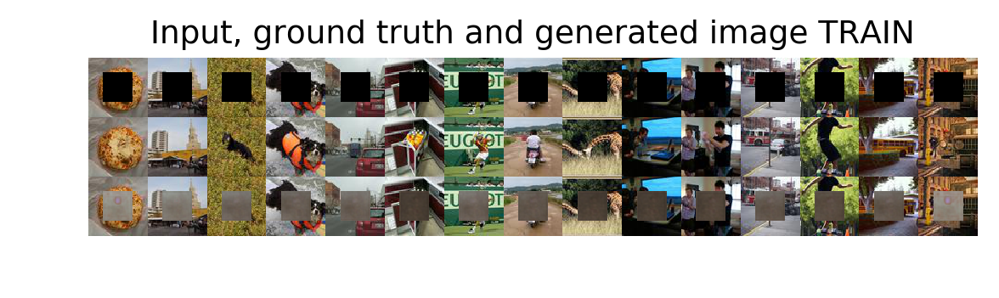

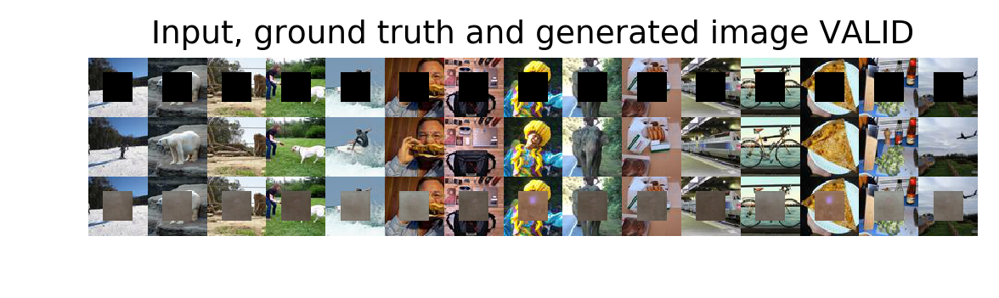

EPOCH 0: Avg cost train 0.061407, cost val 0.126568, took 41.339829 s


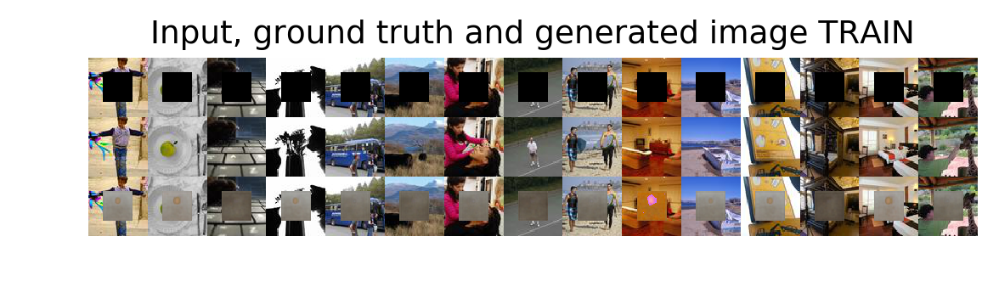

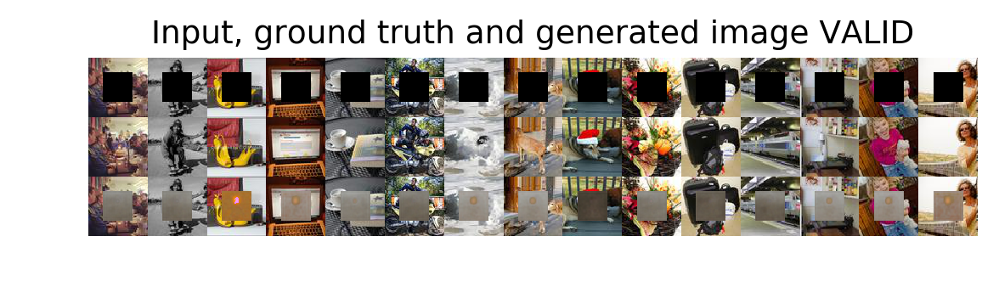

EPOCH 1: Avg cost train 0.058648, cost val 0.113158, took 37.044553 s
saving last model


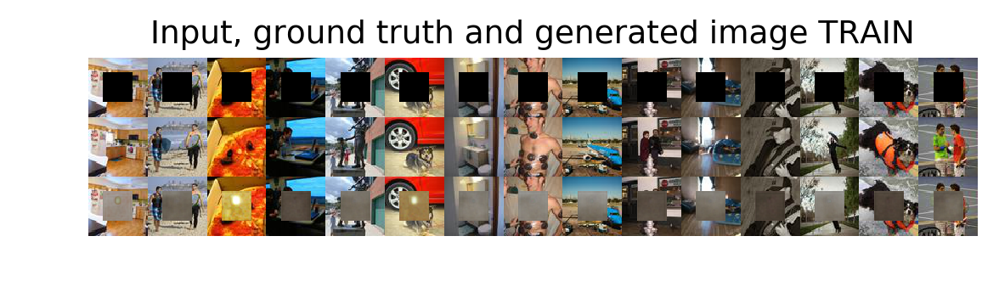

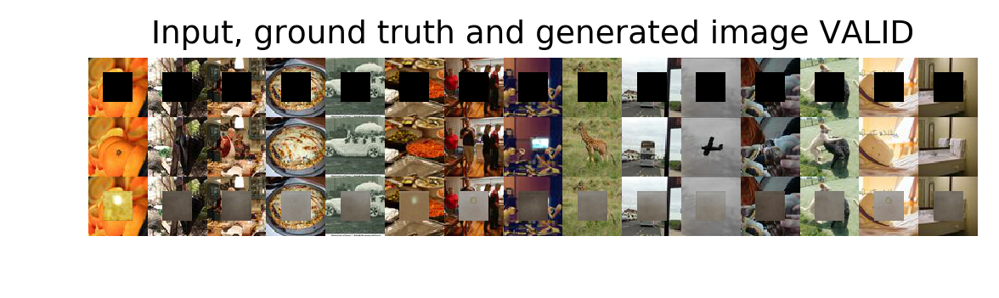

EPOCH 2: Avg cost train 0.057416, cost val 0.111408, took 39.925368 s
saving best (and last) model


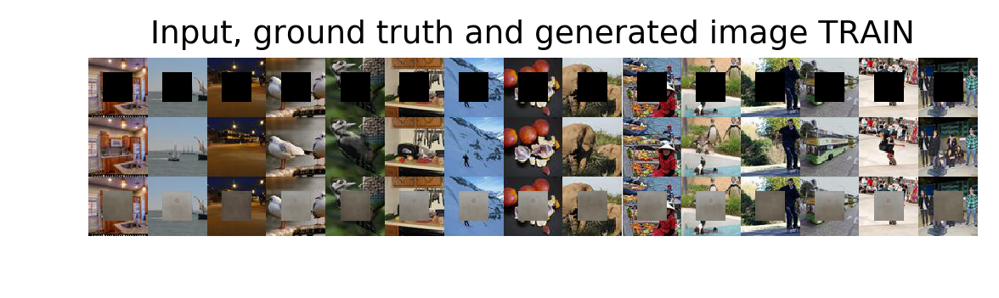

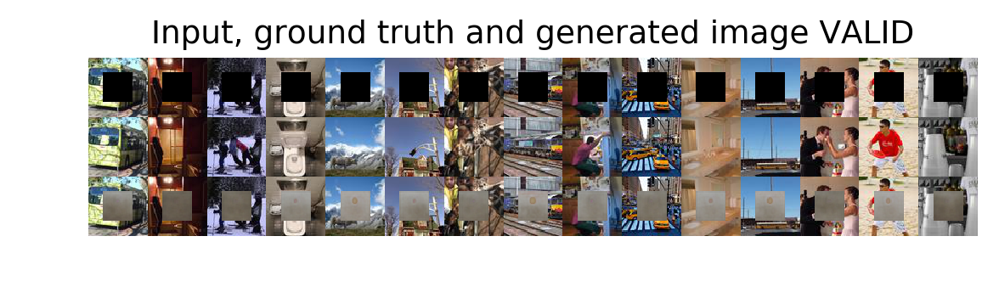

EPOCH 3: Avg cost train 0.056604, cost val 0.114738, took 38.424234 s
saving last model


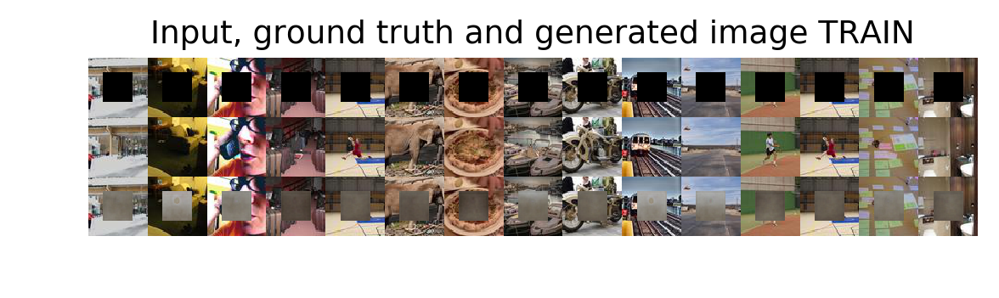

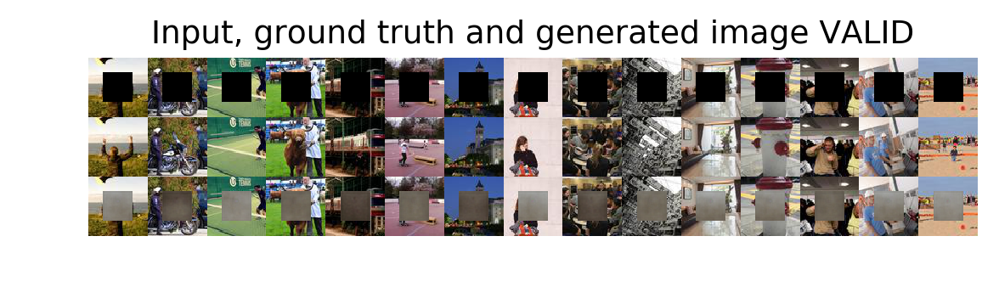

EPOCH 4: Avg cost train 0.055917, cost val 0.108079, took 43.117016 s
saving best (and last) model


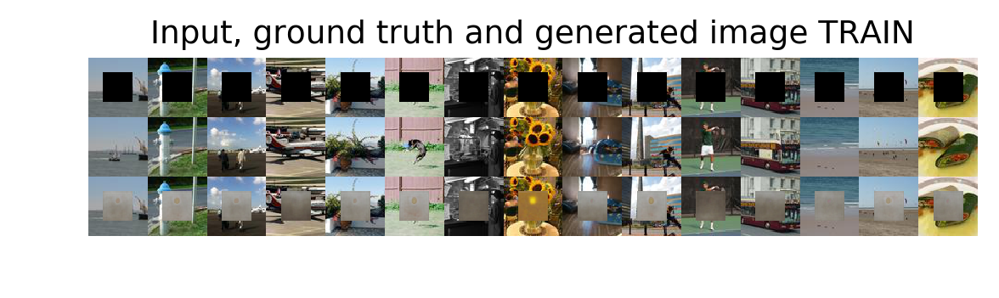

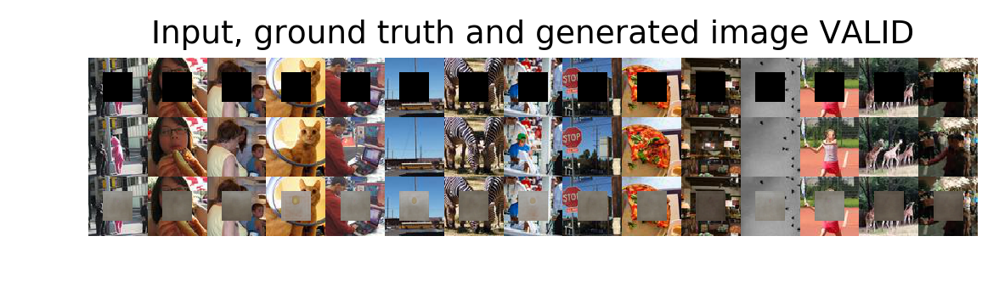

EPOCH 5: Avg cost train 0.055482, cost val 0.114440, took 37.893550 s
saving last model


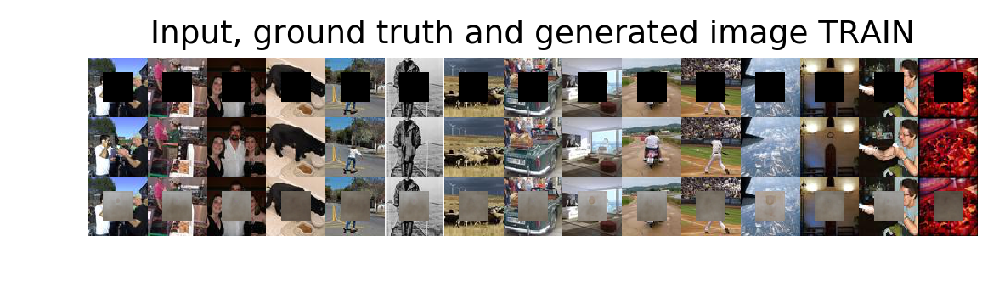

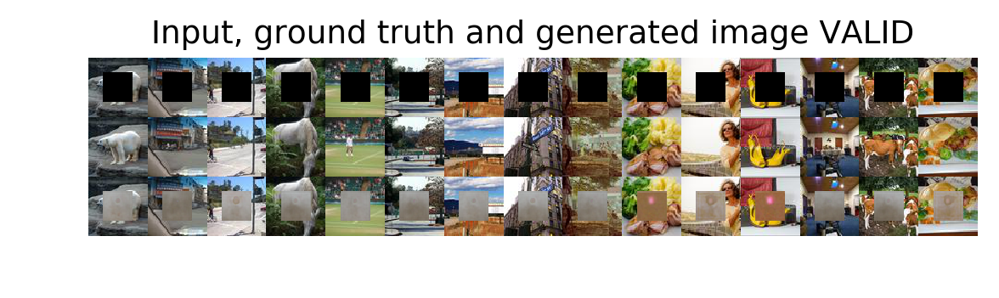

EPOCH 6: Avg cost train 0.055438, cost val 0.125853, took 41.008941 s
saving last model


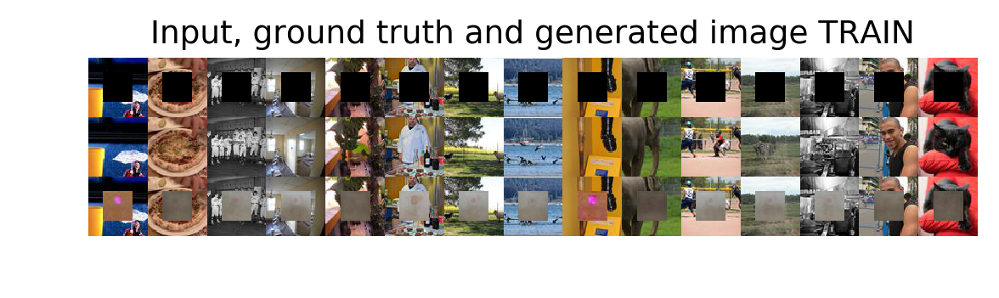

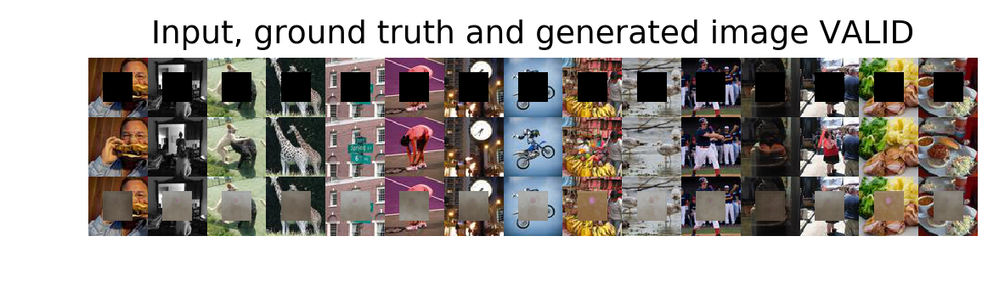

EPOCH 7: Avg cost train 0.055011, cost val 0.113235, took 38.739129 s
saving last model


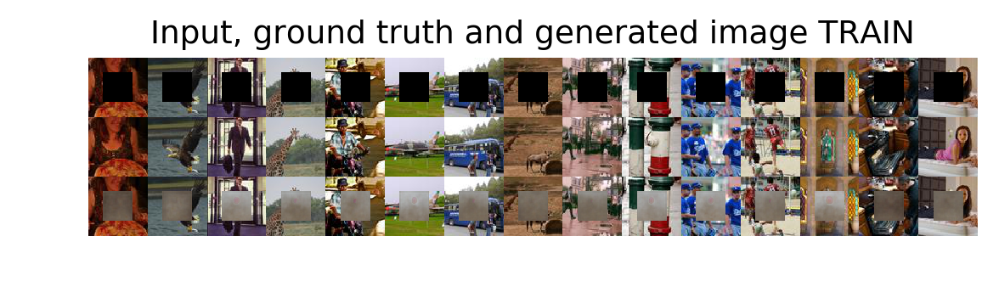

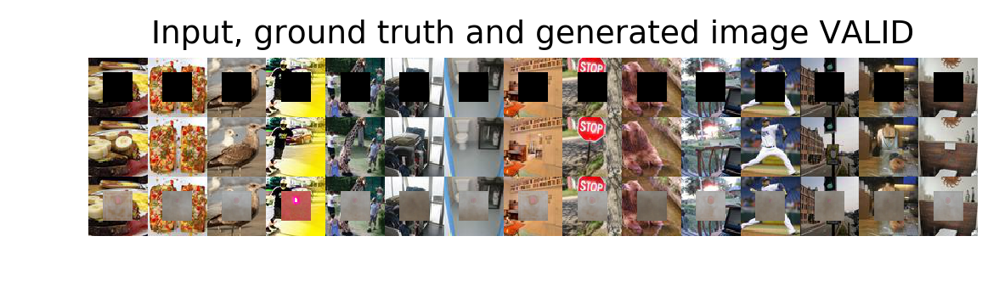

EPOCH 8: Avg cost train 0.054546, cost val 0.121481, took 41.101711 s
saving last model


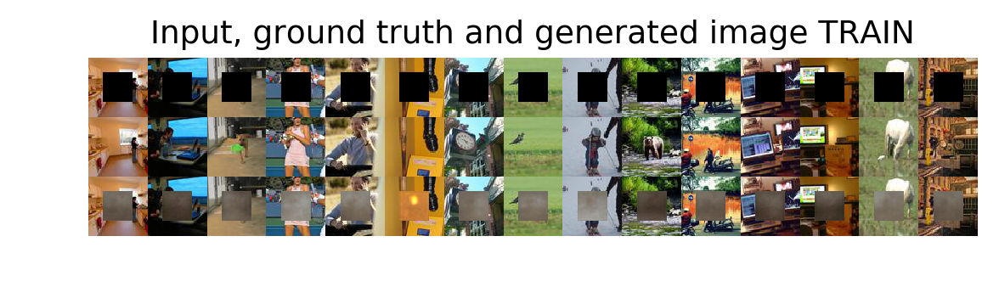

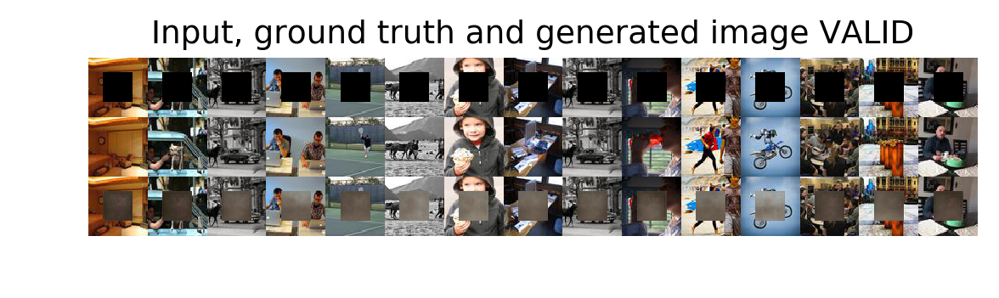

EPOCH 9: Avg cost train 0.053984, cost val 0.111068, took 40.946880 s
saving last model


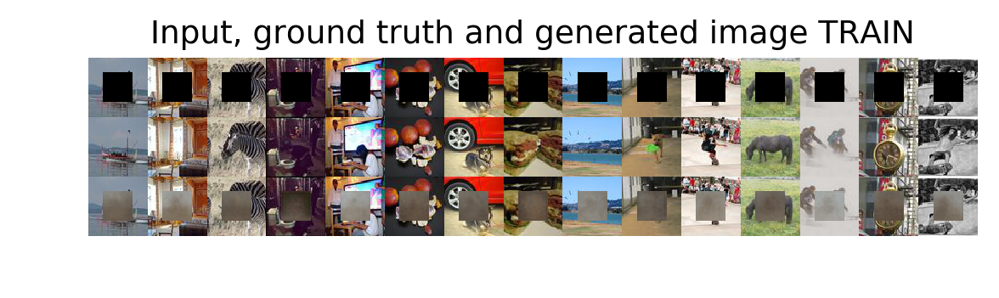

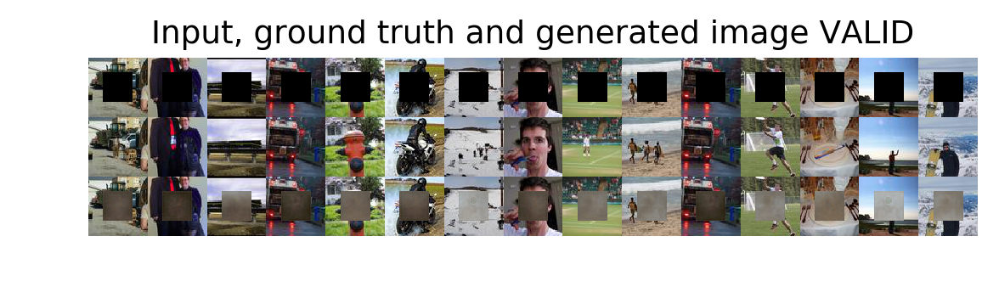

EPOCH 10: Avg cost train 0.053386, cost val 0.111786, took 40.672983 s
saving last model


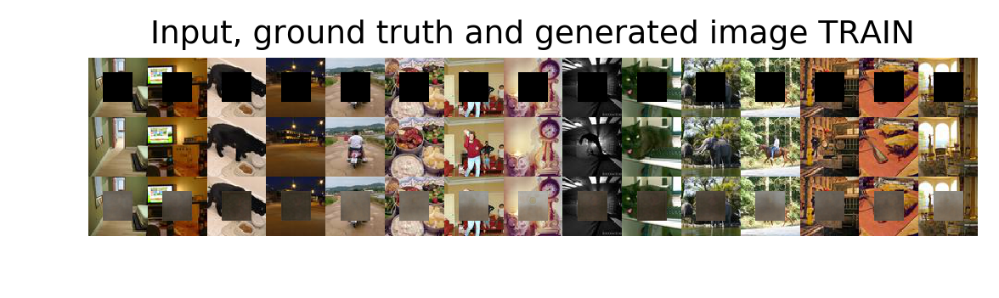

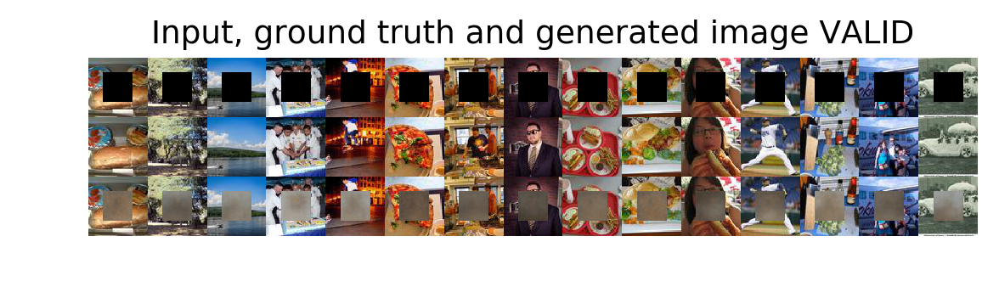

EPOCH 11: Avg cost train 0.053005, cost val 0.108829, took 40.275800 s
saving last model


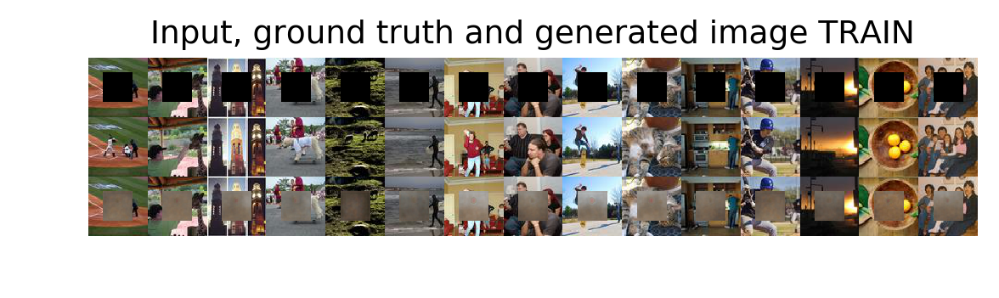

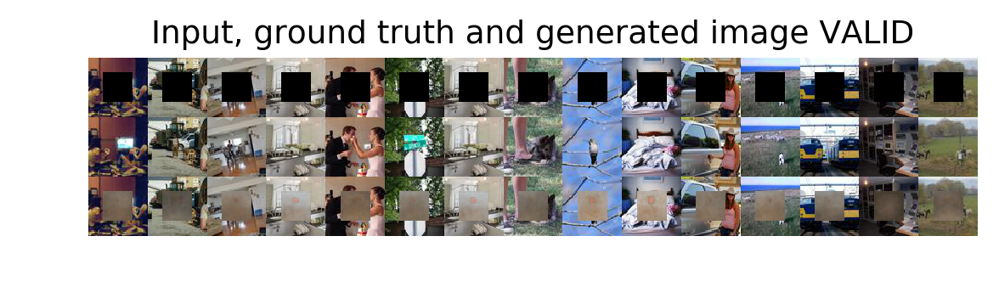

EPOCH 12: Avg cost train 0.053206, cost val 0.108515, took 36.321294 s
saving last model


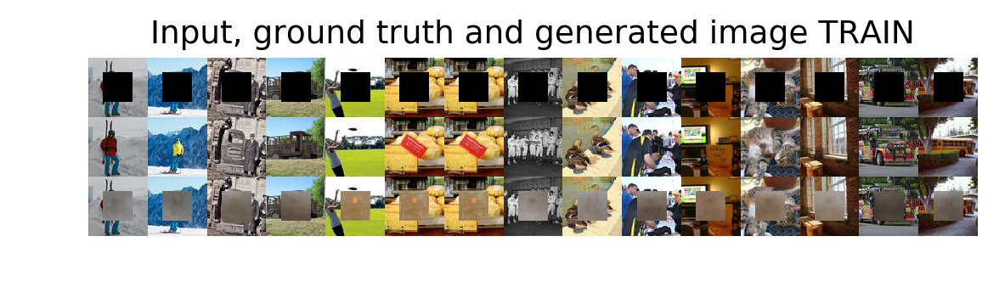

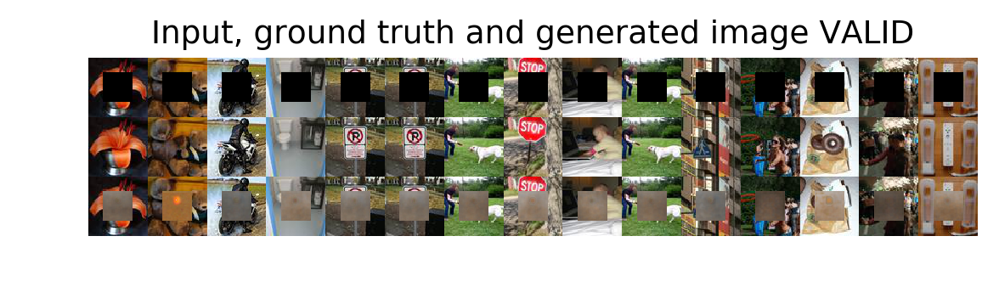

EPOCH 13: Avg cost train 0.052881, cost val 0.108572, took 39.345067 s
saving last model


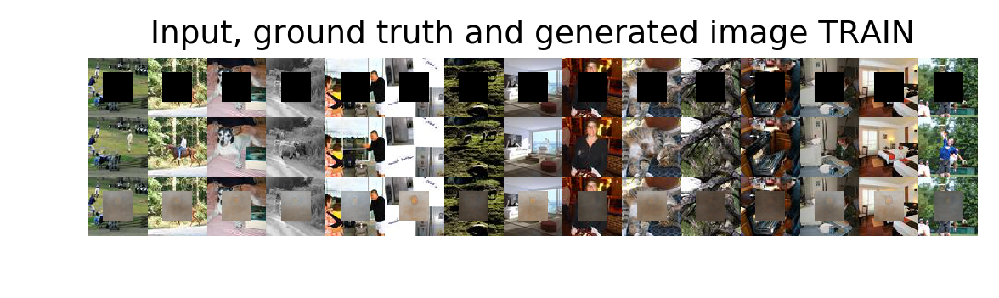

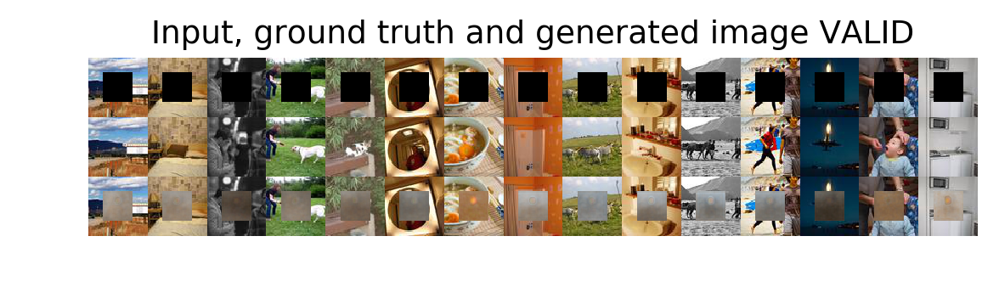

EPOCH 14: Avg cost train 0.052479, cost val 0.109309, took 39.468398 s
saving last model


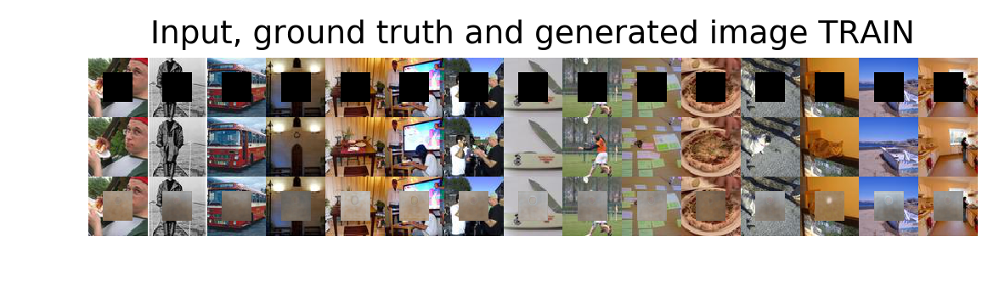

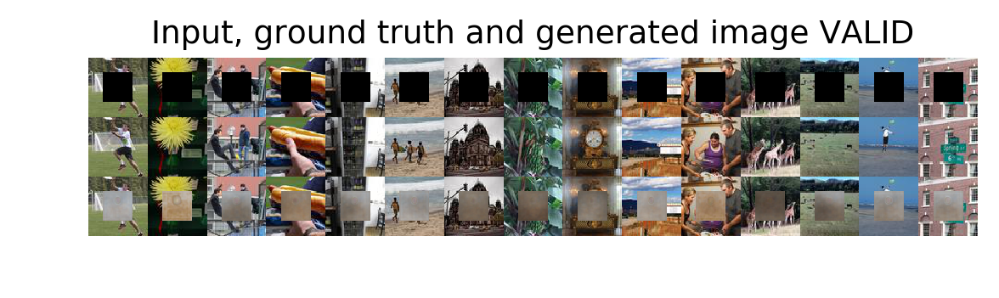

EPOCH 15: Avg cost train 0.052122, cost val 0.117007, took 36.564547 s
saving last model


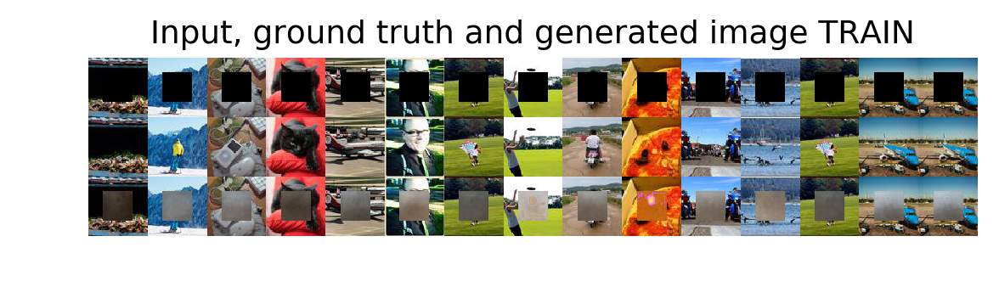

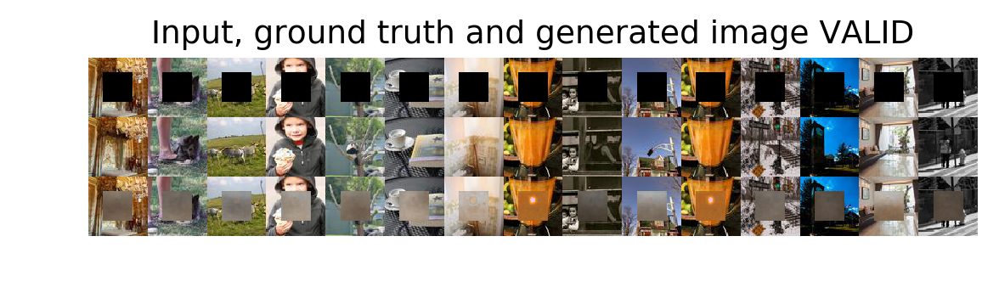

EPOCH 16: Avg cost train 0.051850, cost val 0.107823, took 42.645189 s
saving best (and last) model


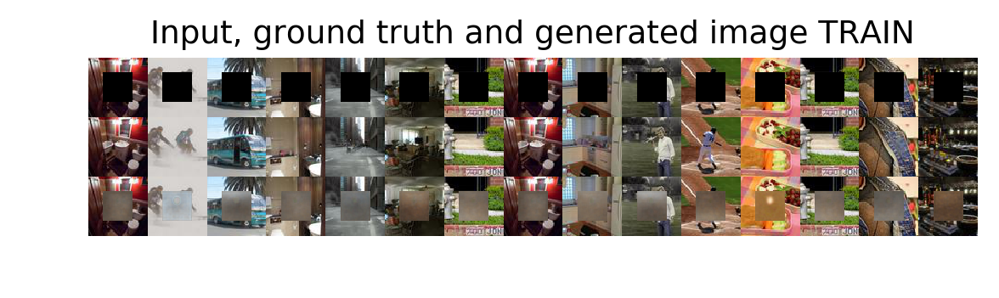

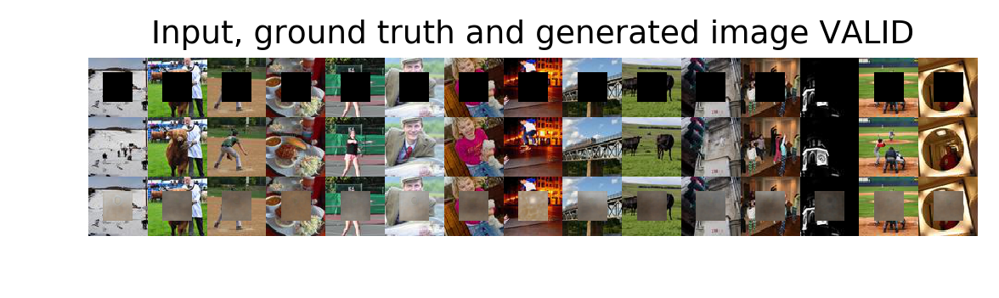

EPOCH 17: Avg cost train 0.051633, cost val 0.106019, took 38.214658 s
saving best (and last) model


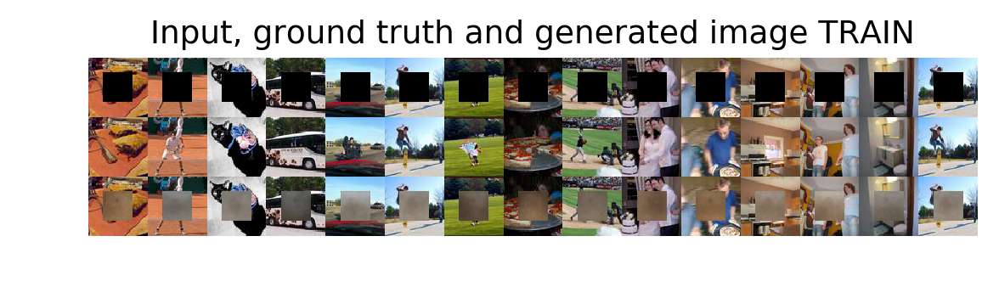

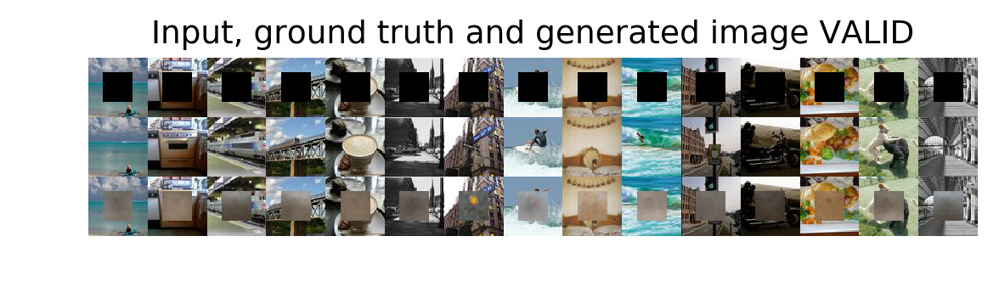

EPOCH 18: Avg cost train 0.051473, cost val 0.107185, took 41.950621 s
saving last model


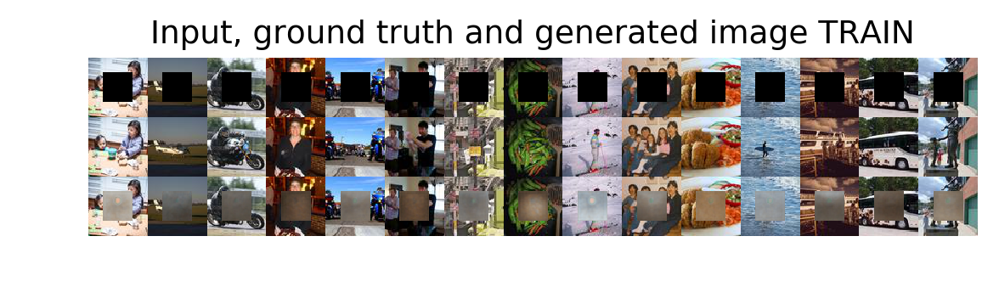

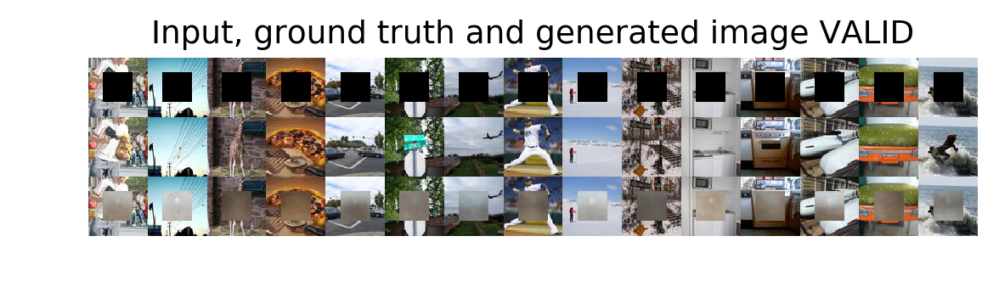

EPOCH 19: Avg cost train 0.051443, cost val 0.105939, took 41.127760 s
saving best (and last) model


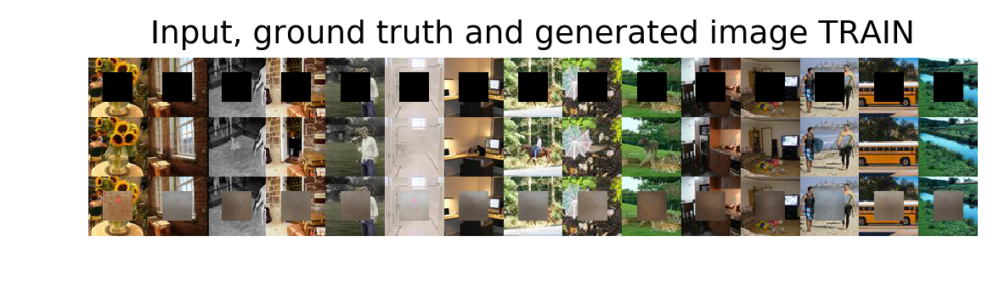

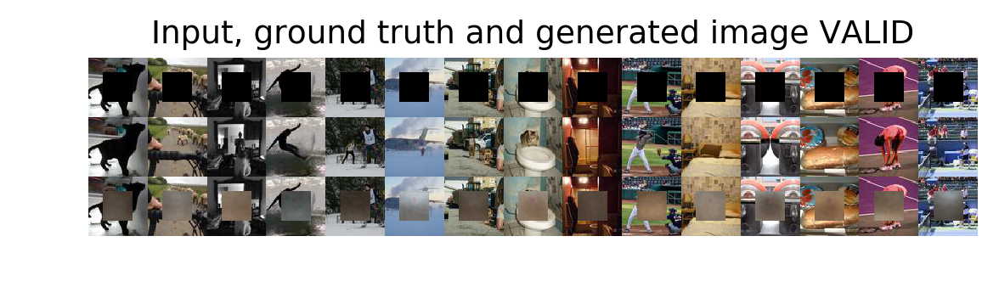

EPOCH 20: Avg cost train 0.051105, cost val 0.107376, took 37.490802 s
saving last model


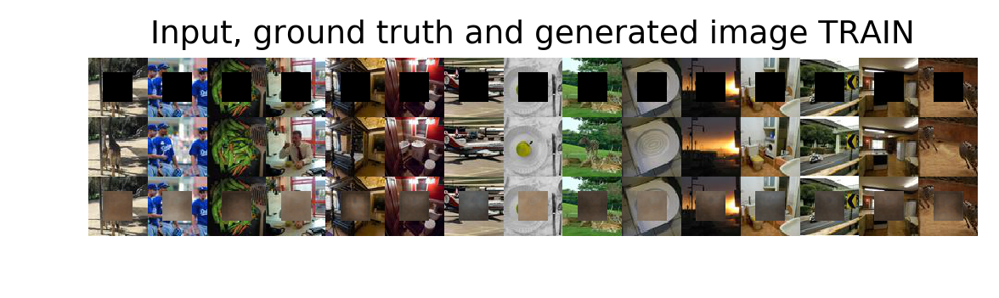

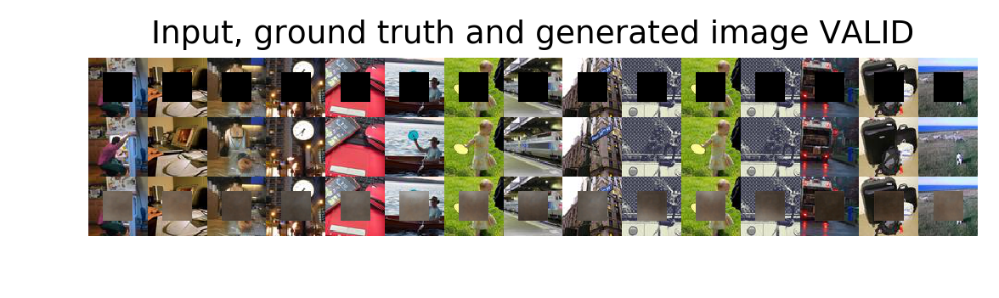

EPOCH 21: Avg cost train 0.050861, cost val 0.115430, took 42.420336 s
saving last model


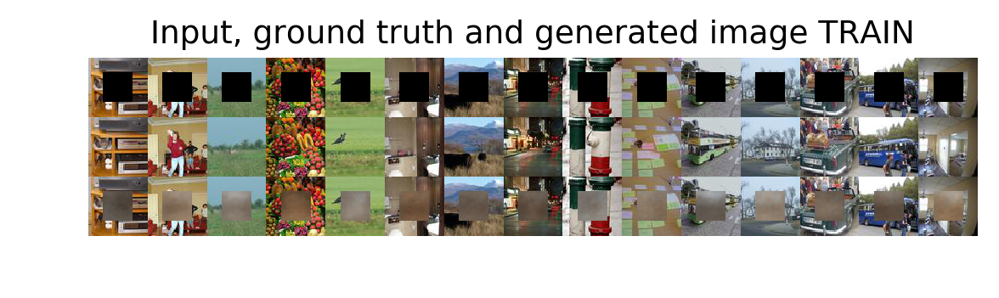

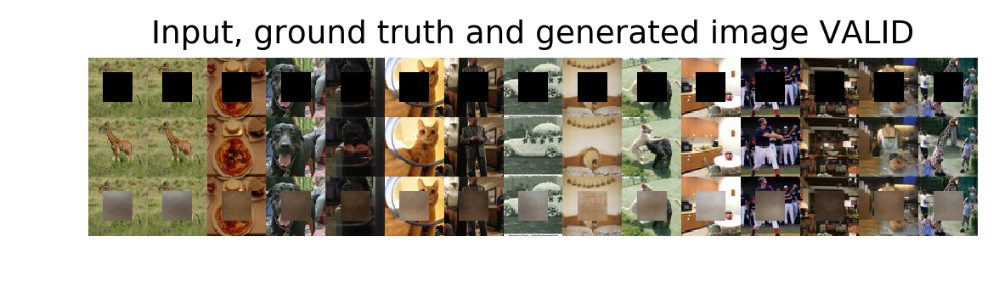

EPOCH 22: Avg cost train 0.050591, cost val 0.106194, took 41.239795 s
saving last model


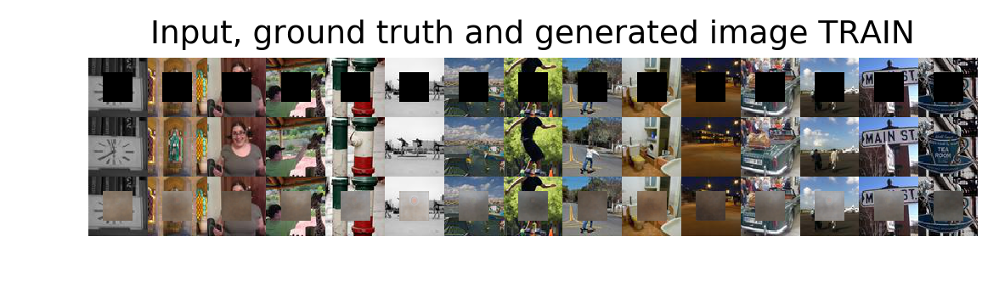

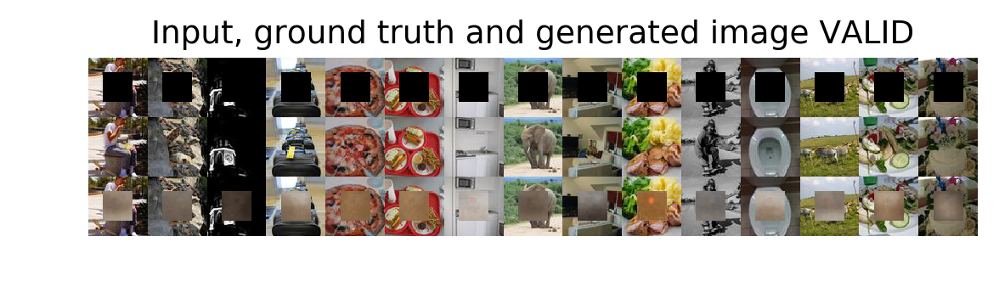

EPOCH 23: Avg cost train 0.050406, cost val 0.109210, took 41.044579 s
saving last model


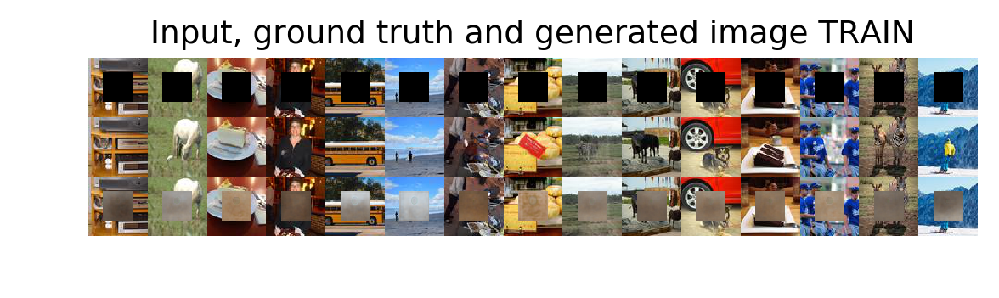

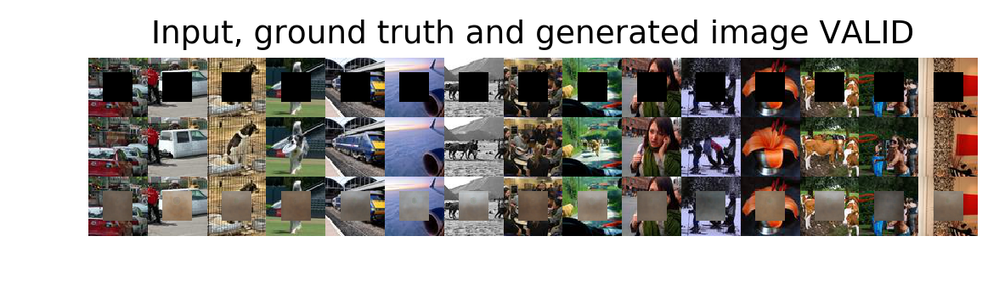

EPOCH 24: Avg cost train 0.050813, cost val 0.108930, took 35.962196 s
saving last model


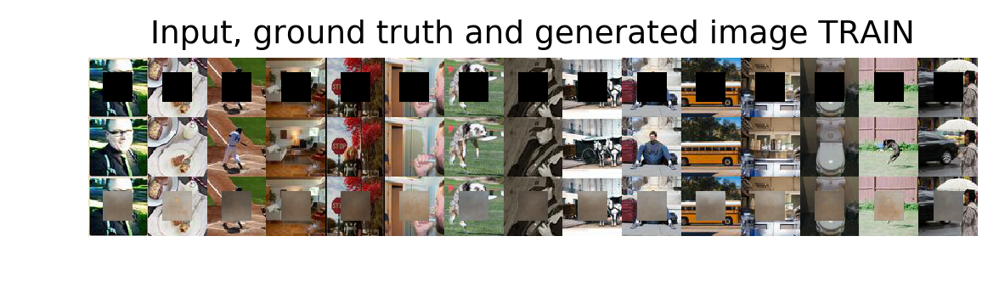

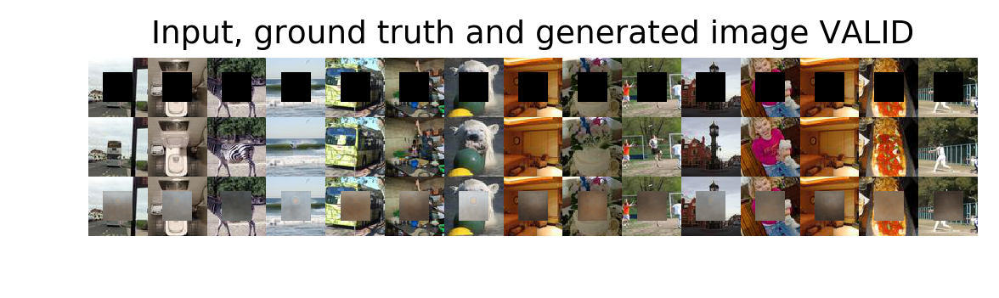

EPOCH 25: Avg cost train 0.051803, cost val 0.105634, took 40.163271 s
saving best (and last) model


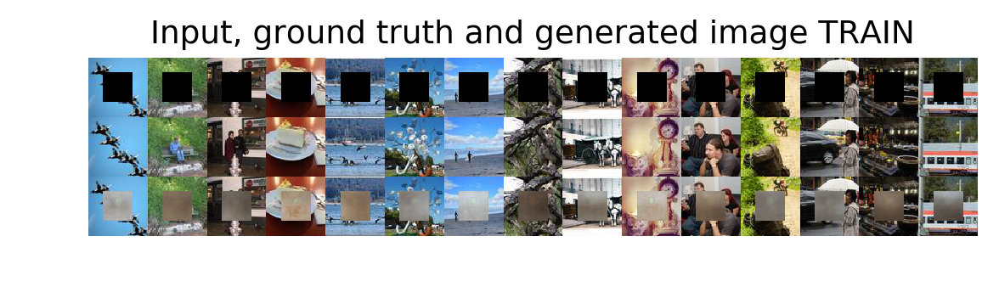

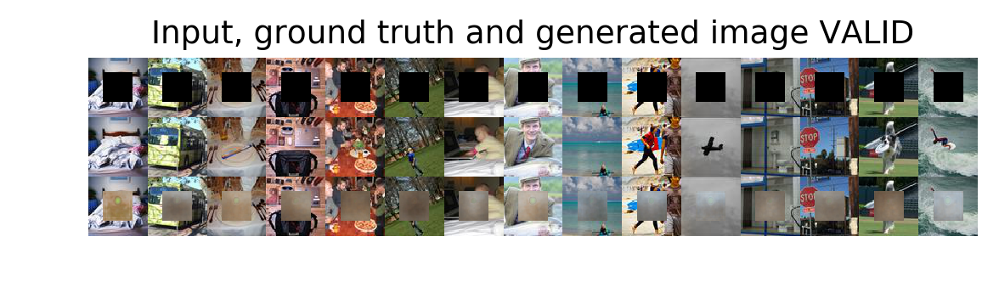

EPOCH 26: Avg cost train 0.051412, cost val 0.111083, took 39.305473 s
saving last model


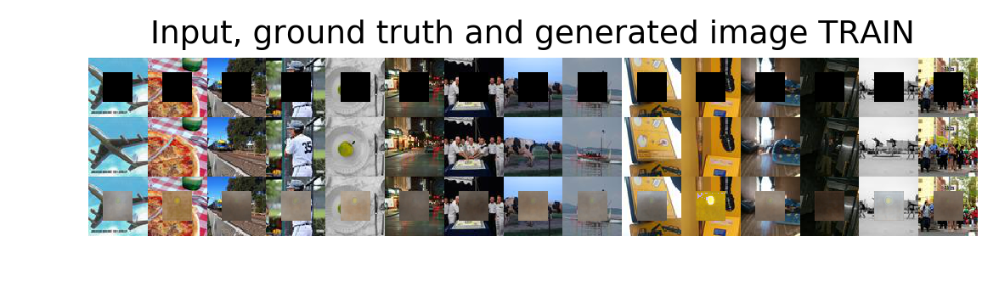

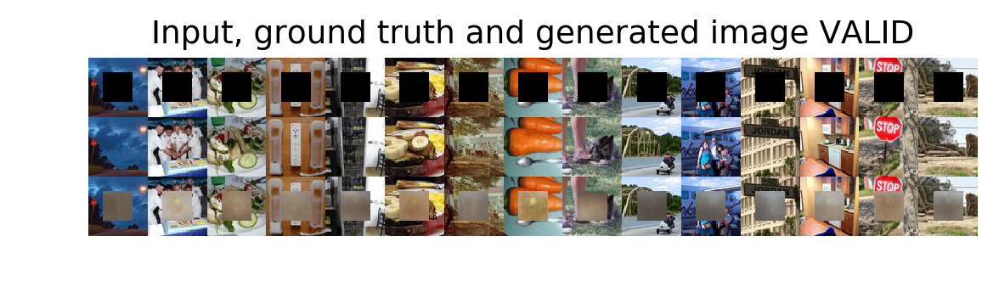

EPOCH 27: Avg cost train 0.051028, cost val 0.108526, took 40.373902 s
saving last model


In [ ]:
#
# Train loop
#



# Training main loop
print "Start training"

for epoch in range(num_epochs):
    #learn_step.set_value((learn_step.get_value()*0.99).astype(theano.config.floatX))
    
    start_time = time.time()
    cost_train_epoch = 0
    
    # Train      
        
    for i, train_batch in enumerate(train_iter):
        #print i
        if n_batches_train > 0 and i> n_batches_train:
            break
        
        #print np.shape(train_batch[0])
        
        train_batch = model.extract_batch(train_batch)
        #print np.shape(train_batch[0])
        inputs_train, targets_train, caps_train = train_batch
        
        cost_train_batch = model.train_fn(inputs_train, caps_train, targets_train)
        
        #Update epoch results    
        cost_train_epoch += cost_train_batch
    
    if plot_results_train: #select random example from the last minibatch and plot it
        model.compute_and_plot_results(train_batch, title = 'TRAIN')
        
        
    #Add epoch results    
    err_train += [cost_train_epoch/n_batches_train]
    

    # Validation
    cost_val_epoch = 0
    

    for i, valid_batch in enumerate(valid_iter):
        
        if n_batches_valid > 0 and i> n_batches_valid:
            break

        valid_batch = model.extract_batch(valid_batch)
        inputs_valid, targets_valid, caps_valid = valid_batch

        # Validation step
        cost_val_batch = model.valid_fn(inputs_valid, caps_valid, targets_valid)
        #print i, 'validation batch cost : ', cost_val_batch


        #Update epoch results
        cost_val_epoch += cost_val_batch
        
    
    if plot_results_valid: #select random example from the last minibatch and plot it
        model.compute_and_plot_results(valid_batch, title = 'VALID')
        
    #Add epoch results 
    err_valid += [cost_val_epoch/n_batches_valid]
    

    #Print results (once per epoch)
    out_str = "EPOCH %i: Avg cost train %f, cost val %f, took %f s"
    out_str = out_str % (epoch, err_train[epoch],
                         #acc_train[epoch],
                         err_valid[epoch],
                         #acc_valid[epoch],
                         time.time()-start_time)
    print out_str
   
    

    # Early stopping and saving stuff
    
    with open(os.path.join(savepath, "ae_output.log"), "a") as f:
        f.write(out_str + "\n")
        
    if epoch == 0 and reset_best_results:
        best_err_valid = err_valid[epoch]
    elif epoch > 1 and err_valid[epoch] < best_err_valid:
        print('saving best (and last) model')
        best_err_valid = err_valid[epoch]
        patience = 0
        np.savez(os.path.join(savepath, 'ae_model_best.npz'),*lasagne.layers.get_all_param_values(model.net))
        np.savez(os.path.join(savepath , "ae_errors_best.npz"), err_train=err_train, err_valid=err_valid)
        np.savez(os.path.join(savepath, 'ae_model_last.npz'),*lasagne.layers.get_all_param_values(model.net))
        np.savez(os.path.join(savepath , "ae_errors_last.npz"),err_train=err_train, err_valid=err_valid)
    else:
        patience += 1
        print('saving last model')
        np.savez(os.path.join(savepath, 'ae_model_last.npz'),*lasagne.layers.get_all_param_values(model.net))
        np.savez(os.path.join(savepath , "ae_errors_last.npz"),err_train=err_train, err_valid=err_valid)
        
    # Finish training if patience has expired or max nber of epochs reached
    if patience == max_patience or epoch == num_epochs-1:
        if savepath != loadpath:
            print('Copying model and other training files to {}'.format(loadpath))
            copy_tree(savepath, loadpath)
        break 


